# セクション0 共通セットアップ

In [ ]:
# === GEMINI_API_KEY の設定 ===
if "GEMINI_API_KEY" not in os.environ:
    print("Enter your GEMINI_API_KEY (入力内容は画面に表示されません):")
    gemini_api_key = getpass("GEMINI_API_KEY: ")
    os.environ["GEMINI_API_KEY"] = gemini_api_key

# 簡易チェック
if os.environ.get("GEMINI_API_KEY"):
    print("GEMINI_API_KEY is set in environment.")
else:
    print("Failed to set GEMINI_API_KEY.")

In [3]:
# === Section 0: 共通セットアップ ===

import os
from pathlib import Path
from getpass import getpass
from google.colab import drive

# 1. Google Drive をマウント
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# 2. プロジェクトルート
PROJECT_ROOT = Path("/content/drive/MyDrive/kujiramonaka_experiment")

# 3. サブディレクトリの定義
#    - ベース商品画像を置く場所
#    - フォーマリティ軸 (旧:用途) で生成した画像を保存する場所
#    - ライフステージ軸 (旧:年代) で生成した画像を保存する場所
BASE_IMAGE_DIR = PROJECT_ROOT / "base"
FORMALITY_DIR = PROJECT_ROOT / "images_formality"   # 変更: images_usecase -> images_formality
LIFESTAGE_DIR = PROJECT_ROOT / "images_lifestage"   # 変更: images_age -> images_lifestage

# 4. ディレクトリを作成
BASE_IMAGE_DIR.mkdir(parents=True, exist_ok=True)
FORMALITY_DIR.mkdir(parents=True, exist_ok=True)
LIFESTAGE_DIR.mkdir(parents=True, exist_ok=True)

print("=== Paths ===")
print("PROJECT_ROOT  :", PROJECT_ROOT)
print("BASE_IMAGE_DIR:", BASE_IMAGE_DIR)
print("FORMALITY_DIR :", FORMALITY_DIR)
print("LIFESTAGE_DIR :", LIFESTAGE_DIR)

=== Paths ===
PROJECT_ROOT  : /content/drive/MyDrive/kujiramonaka_experiment
BASE_IMAGE_DIR: /content/drive/MyDrive/kujiramonaka_experiment/base
FORMALITY_DIR : /content/drive/MyDrive/kujiramonaka_experiment/images_formality
LIFESTAGE_DIR : /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage


# セクション1 プロンプト定義


In [ ]:
# === Section 1: プロンプト定義（用途・年代で本当に「ペルソナ情報だけ」が違う版） ===

# -----------------------------------------------------------------------------
# 1-1. 共通のプロダクト・画像制約
# -----------------------------------------------------------------------------
PRODUCT_IMAGE_CONSTRAINTS = """
You are a professional Creative Director and AI Image Generator.

# Task
Generate a promotional banner image for "Kujira Monaka" in a Square (1:1) format.

# Product Constraints (FIXED)
- Subject: The product is "Kujira Monaka" (whale-shaped Japanese wafer sweets).
- Use the reference product photo as the visual standard.
- Keep the realistic texture very close to the reference.
- Do NOT redesign it or turn it into a different dessert.
- Do NOT hide the sweets behind large objects or text.
- Include the Japanese text "くじらもなか" naturally in the layout.

# Common mistakes to avoid
- Do NOT add realistic whale features the product does not have.
- Do NOT enlarge or reshape the fins.
- Do NOT create a new whale character silhouette.

# Image Constraints
- Output format: Square (1:1)
- Clean, commercial-quality visual
- Must look like a realistic product photo
"""

# -----------------------------------------------------------------------------
# 1-2. フォーマリティ軸ベースプロンプト
# -----------------------------------------------------------------------------
BASE_PROMPT_FORMALITY = PRODUCT_IMAGE_CONSTRAINTS + """
You must create the most effective visual for a specific "Gift Scene Formality Level"
by translating the scene context into appropriate visual elements
(background, lighting, props, spatial arrangement, overall atmosphere).

# Gift Scene Formality Scale (Private → Social → Ritual)

- Level 1: Private Everyday Use
  Fully private daily consumption. Informal, relaxed, and simple.

- Level 2: Personal Treat / Self-Gift
  Slightly elevated private experience. Still informal but more intentional and refined.

- Level 3: Casual Gift for Family / Close Friends
  Warm, familiar, friendly gifting scenes within personal relationships.

- Level 4: Formal Gift for Workplace / Social Relations
  Clean, polite, structured design appropriate for colleagues, clients, or superiors.

- Level 5: Ritual / Ceremonial Gift
  Highly formal, culturally appropriate presentation for greetings, rites, and respectful occasions.

Very important:
- Each image generation is independent.
- You must mentally use this scale and design a visual that clearly matches its level
  when compared side-by-side with others.
- Use environment, lighting, and props to express the degree of formality.

Below you will receive the target Formality Level and additional instructions.
Do NOT ask any questions.
"""


# -----------------------------------------------------------------------------
# 1-3. ライスステージ軸ベースプロンプト
# -----------------------------------------------------------------------------
BASE_PROMPT_LIFESTAGE = PRODUCT_IMAGE_CONSTRAINTS + """
You must create the most effective visual for a specific "Life-Stage Persona Level"
by translating the persona's lifestyle and psychological tendencies into concrete visual choices
(background, lighting, props, arrangement, overall atmosphere).

# Life-Stage Persona Scale

- Level 1: Children (0–12)
  Playful, curious, and responsive to simple, friendly visuals.

- Level 2: Youth / Students (13–25)
  Trend-sensitive, expressive, and exploratory. Influenced by digital culture.

- Level 3: Early Working Adults (26–35)
  Starting independent careers; prefer modern, practical, lifestyle-aligned visuals.

- Level 4: Family & Established Adults (35–60)
  Value reliability, appropriateness, and care for family or social context.

- Level 5: Seniors (60+)
  Value familiarity, comfort, clarity, and gentle aesthetics.

Very important:
- Each generation is independent.
- Ensure that the visual clearly matches its life-stage when compared side-by-side.

Below you will receive the target Life-Stage Level and instructions.
Do NOT ask any questions.
"""


# -----------------------------------------------------------------------------
# 2. 共通 Instructions（Formality / Life-stage）
#    ※ここがレベルによらず完全共通になる
# -----------------------------------------------------------------------------

INSTRUCTIONS_FORMALITY = """
Instructions:
Create a visual design that clearly reflects the "Target gift-scene formality" described above.
Use your knowledge of advertising and visual design to choose the environment, arrangement,
lighting, props, and overall mood, so that the scene is consistent with the Target formality
and makes the intended gifting scene easily recognizable.
"""


INSTRUCTIONS_LIFESTAGE = """
Instructions:
Create a visual design that clearly reflects the "Target life-stage persona" described above.
Use your knowledge of advertising and visual design to choose the environment, arrangement,
lighting, props, and overall mood, so that the scene is consistent with the Target persona
and makes the intended life-stage audience easily recognizable.
"""

# -----------------------------------------------------------------------------
# 3. FORMALITY_LEVEL_PROMPTS（各レベルの指示文）
# -----------------------------------------------------------------------------
FORMALITY_LEVEL_PROMPTS = {
    1: f"""
[FORMALITY LEVEL 1: Private Everyday Use]

Target gift-scene formality:
- Completely private consumption.
- Casual, relaxed, and unstructured context.

{INSTRUCTIONS_FORMALITY}
""",

    2: f"""
[FORMALITY LEVEL 2: Personal Treat / Self-Gift]

Target gift-scene formality:
- A slightly elevated personal experience.
- Still private, but intentional and gently refined.

{INSTRUCTIONS_FORMALITY}
""",

    3: f"""
[FORMALITY LEVEL 3: Gift for Family / Close Friends]

Target gift-scene formality:
- Warm, friendly gifting among close relationships.
- Informal but thoughtful atmosphere.

{INSTRUCTIONS_FORMALITY}
""",

    4: f"""
[FORMALITY LEVEL 4: Workplace / Social Formal Gift]

Target gift-scene formality:
- Polite, structured, socially appropriate gifting context.
- Suitable for colleagues, clients, or superiors.

{INSTRUCTIONS_FORMALITY}
""",

    5: f"""
[FORMALITY LEVEL 5: Ritual / Ceremonial Gift]

Target gift-scene formality:
- Highest level of formality.
- Suitable for ceremonial greetings, seasonal rituals, or highly respectful situations.

{INSTRUCTIONS_FORMALITY}
"""
}

def build_formality_prompt(level: int) -> str:
    return BASE_PROMPT_FORMALITY + "\n\n" + FORMALITY_LEVEL_PROMPTS[level]


# -----------------------------------------------------------------------------
# 4. LIFESTAGE_LEVEL_PROMPTS（各レベルの指示文）
# -----------------------------------------------------------------------------
LIFESTAGE_LEVEL_PROMPTS = {
    1: f"""
[LIFESTAGE LEVEL 1: Children]

Target persona:
- Playful, curious, easily engaged by friendly and simple visuals.

{INSTRUCTIONS_LIFESTAGE}
""",

    2: f"""
[LIFESTAGE LEVEL 2: Youth / Students]

Target persona:
- Trend-conscious, expressive, influenced by peers and digital culture.

{INSTRUCTIONS_LIFESTAGE}
""",

    3: f"""
[LIFESTAGE LEVEL 3: Early Working Adults]

Target persona:
- Prefer practical, modern visuals aligned with daily routines.

{INSTRUCTIONS_LIFESTAGE}
""",

    4: f"""
[LIFESTAGE LEVEL 4: Family & Established Adults]

Target persona:
- Value appropriateness, reliability, and warm but structured visuals.

{INSTRUCTIONS_LIFESTAGE}
""",

    5: f"""
[LIFESTAGE LEVEL 5: Seniors]

Target persona:
- Prefer familiar, gentle, comforting, and easy-to-read visuals.

{INSTRUCTIONS_LIFESTAGE}
"""
}

def build_lifestage_prompt(level: int) -> str:
    return BASE_PROMPT_LIFESTAGE + "\n\n" + LIFESTAGE_LEVEL_PROMPTS[level]

In [ ]:
# === Section 1 (確認用): 全軸・全レベルのプロンプト表示 ===

def print_full_prompts():
    divider = "=" * 80
    sub_divider = "-" * 80

    print(divider)
    print("PROMPT CHECK: FORMALITY AXIS (Lv1 - Lv5)")
    print(divider)

    for level in range(1, 6):
        prompt_text = build_formality_prompt(level)
        print(f"\n>>> [FORMALITY LEVEL {level}]")
        print(sub_divider)
        print(prompt_text)
        print(sub_divider)

    print("\n" * 2)
    print(divider)
    print("PROMPT CHECK: LIFESTAGE AXIS (Lv1 - Lv5)")
    print(divider)

    for level in range(1, 6):
        prompt_text = build_lifestage_prompt(level)
        print(f"\n>>> [LIFESTAGE LEVEL {level}]")
        print(sub_divider)
        print(prompt_text)
        print(sub_divider)

# 実行
print_full_prompts()

PROMPT CHECK: FORMALITY AXIS (Lv1 - Lv5)

>>> [FORMALITY LEVEL 1]
--------------------------------------------------------------------------------

You are a professional Creative Director and AI Image Generator.

# Task
Generate a promotional banner image for "Kujira Monaka" in a Square (1:1) format.

# Product Constraints (FIXED)
- Subject: The product is "Kujira Monaka" (whale-shaped Japanese wafer sweets).
- Use the reference product photo as the visual standard.
- Keep the realistic texture very close to the reference.
- Do NOT redesign it or turn it into a different dessert.
- Do NOT hide the sweets behind large objects or text.
- Include the Japanese text "くじらもなか" naturally in the layout.

# Common mistakes to avoid
- Do NOT add realistic whale features the product does not have.
- Do NOT enlarge or reshape the fins.
- Do NOT create a new whale character silhouette.

# Image Constraints
- Output format: Square (1:1)
- Clean, commercial-quality visual
- Must look like a realistic

# Section 2: 画像生成クライアント & バッチ生成

In [ ]:
# === Section 2: Gemini 3 Pro Image 生成クライアント ===

# 必要ライブラリのインストール
!pip install -q google-genai pillow

import os
import time
import math
from io import BytesIO
from pathlib import Path

# 【重要】名前衝突を避けるため PIL.Image を PILImage としてインポート
from PIL import Image as PILImage
import matplotlib.pyplot as plt

from google import genai
from google.genai import types

# 1. クライアント初期化
GEMINI_API_KEY = os.environ.get("GEMINI_API_KEY")
if not GEMINI_API_KEY:
    raise RuntimeError("GEMINI_API_KEY が環境変数に設定されていません。")

client = genai.Client(api_key=GEMINI_API_KEY)

# 2. モデルID (Gemini 3 Pro Image Preview)
MODEL_ID = "gemini-3-pro-image-preview"

# 3. ベース画像のパス定義
BASE_IMAGE_FILENAME = "kujira_base.png"
BASE_IMAGE_PATH = BASE_IMAGE_DIR / BASE_IMAGE_FILENAME

def load_base_image(path: Path) -> PILImage.Image:
    """ベース画像を読み込み、RGB変換して返す"""
    if not path.exists():
        raise FileNotFoundError(f"ベース画像が見つかりません: {path}\n画像を {BASE_IMAGE_DIR} にアップロードしてください。")
    return PILImage.open(path).convert("RGB")

# 4. 個別画像生成関数
def generate_kujira_image(
    prompt: str,
    base_image: PILImage.Image,
    aspect_ratio: str = "1:1",
):
    """Gemini 3 Pro Image Preview を使用して画像生成を行う"""
    config = types.GenerateContentConfig(
        response_modalities=["IMAGE"],
        image_config=types.ImageConfig(aspect_ratio=aspect_ratio)
    )

    try:
        response = client.models.generate_content(
            model=MODEL_ID,
            contents=[prompt, base_image],
            config=config
        )
    except Exception as e:
        raise RuntimeError(f"Gemini API Request Error: {e}")

    generated_img = None
    if response.parts:
        for part in response.parts:
            if part.inline_data and part.inline_data.data:
                try:
                    img_bytes = part.inline_data.data
                    generated_img = PILImage.open(BytesIO(img_bytes)).convert("RGB")
                    break
                except Exception as e:
                    print(f"Warning: Failed to decode image part: {e}")
                    continue

    if generated_img is None:
        text_content = ""
        if hasattr(response, 'text') and response.text:
            text_content = response.text
        raise RuntimeError(f"画像が生成されませんでした。Response Text: {text_content}")

    return generated_img

def save_kujira_image(img: PILImage.Image, out_path: Path) -> Path:
    out_path.parent.mkdir(parents=True, exist_ok=True)
    img.save(out_path, format="PNG")
    return out_path

def preview_images(image_paths, max_images: int = 9, title: str | None = None):
    if not image_paths:
        print("No images to preview.")
        return
    paths = image_paths[:max_images]
    n = len(paths)
    cols = min(3, n)
    rows = math.ceil(n / cols)
    plt.figure(figsize=(4 * cols, 4 * rows))
    for i, p in enumerate(paths):
        img = PILImage.open(p)
        ax = plt.subplot(rows, cols, i + 1)
        ax.imshow(img)
        ax.set_title(p.name, fontsize=8)
        ax.axis("off")
    if title:
        plt.suptitle(title, fontsize=12)
    plt.tight_layout()
    plt.show()

# ----------------------------------------------------------------
# 5. フォーマリティ軸 (Formality) のバッチ生成
# ----------------------------------------------------------------
def generate_formality_batch(
    level: int,
    n_images: int = 30,
    output_dir: Path = FORMALITY_DIR,
    preview: bool = False,
):
    print(f"Loading base image from: {BASE_IMAGE_PATH}")
    base_img = load_base_image(BASE_IMAGE_PATH)

    prompt = build_formality_prompt(level)
    print(f"[FORMALITY] Level {level} / n={n_images}")

    generated_paths: list[Path] = []
    for i in range(n_images):
        try:
            img = generate_kujira_image(prompt=prompt, base_image=base_img)

            # ファイル名を formality_lvX_XXX.png に変更
            fname = f"formality_lv{level}_{i:03d}.png"
            out_path = output_dir / fname
            save_kujira_image(img, out_path)
            generated_paths.append(out_path)
            print(f"  -> Saved: {out_path}")
            time.sleep(2)
        except Exception as e:
            print(f"  [Error] Failed to generate index {i}: {e}")
            if i > 2:
                print("Too many errors, stopping batch.")
                break

    if preview:
        preview_images(generated_paths, max_images=min(9, n_images), title=f"Formality Lv{level}")
    return generated_paths

# ----------------------------------------------------------------
# 6. ライフステージ軸 (Lifestage) のバッチ生成
# ----------------------------------------------------------------
def generate_lifestage_batch(
    level: int,
    n_images: int = 30,
    output_dir: Path = LIFESTAGE_DIR,
    preview: bool = False,
):
    print(f"Loading base image from: {BASE_IMAGE_PATH}")
    base_img = load_base_image(BASE_IMAGE_PATH)

    prompt = build_lifestage_prompt(level)
    print(f"[LIFESTAGE] Level {level} / n={n_images}")

    generated_paths: list[Path] = []
    for i in range(n_images):
        try:
            img = generate_kujira_image(prompt=prompt, base_image=base_img)

            # ファイル名を lifestage_lvX_XXX.png に変更
            fname = f"lifestage_lv{level}_{i:03d}.png"
            out_path = output_dir / fname
            save_kujira_image(img, out_path)
            generated_paths.append(out_path)
            print(f"  -> Saved: {out_path}")
            time.sleep(2)
        except Exception as e:
            print(f"  [Error] Failed to generate index {i}: {e}")
            if i > 2:
                break

    if preview:
        preview_images(generated_paths, max_images=min(9, n_images), title=f"Lifestage Lv{level}")
    return generated_paths


# ----------------------------------------------------------------
# 7. 全レベル一括生成ヘルパー
# ----------------------------------------------------------------
def generate_formality_all_levels_once(n_images_per_level: int = 1, preview_each_level: bool = True):
    all_paths = []
    for lv in range(1, 6):
        paths = generate_formality_batch(level=lv, n_images=n_images_per_level, preview=preview_each_level)
        all_paths.extend(paths)
    print(f"[FORMALITY] Total generated images: {len(all_paths)}")
    return all_paths

def generate_lifestage_all_levels_once(n_images_per_level: int = 1, preview_each_level: bool = True):
    all_paths = []
    for lv in range(1, 6):
        paths = generate_lifestage_batch(level=lv, n_images=n_images_per_level, preview=preview_each_level)
        all_paths.extend(paths)
    print(f"[LIFESTAGE] Total generated images: {len(all_paths)}")
    return all_paths

print("Section 2: Generation functions ready (Formality & Lifestage).")

Section 2: Generation functions ready (Formality & Lifestage).



>>> Test Run: Formality Axis
Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 1 / n=1
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_000.png


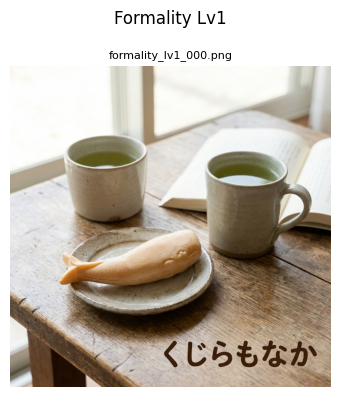

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 2 / n=1
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_000.png


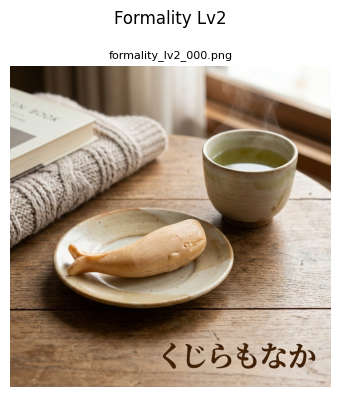

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 3 / n=1
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_000.png


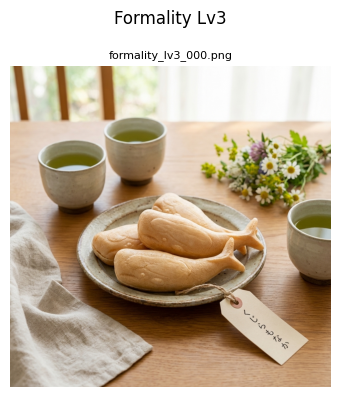

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 4 / n=1
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_000.png


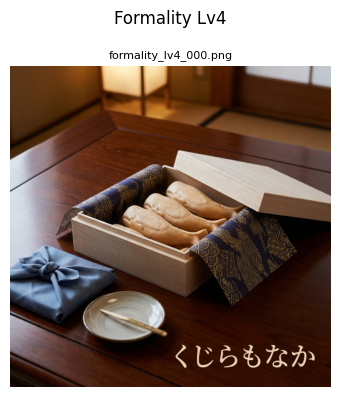

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 5 / n=1
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_000.png


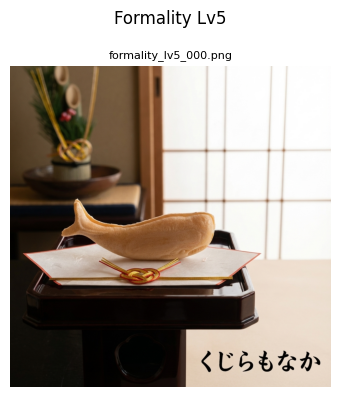

[FORMALITY] Total generated images: 5
------------------------------------------------------------


In [ ]:
# --- テスト生成 (1枚ずつ) ---
print("\n>>> Test Run: Formality Axis")
generate_formality_all_levels_once(n_images_per_level=1, preview_each_level=True)

print("-" * 60)

# print("\n>>> Test Run: Lifestage Axis")
# generate_lifestage_all_levels_once(n_images_per_level=1, preview_each_level=True)



>>> Production Run: Formality Axis
Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 1 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv1_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/i

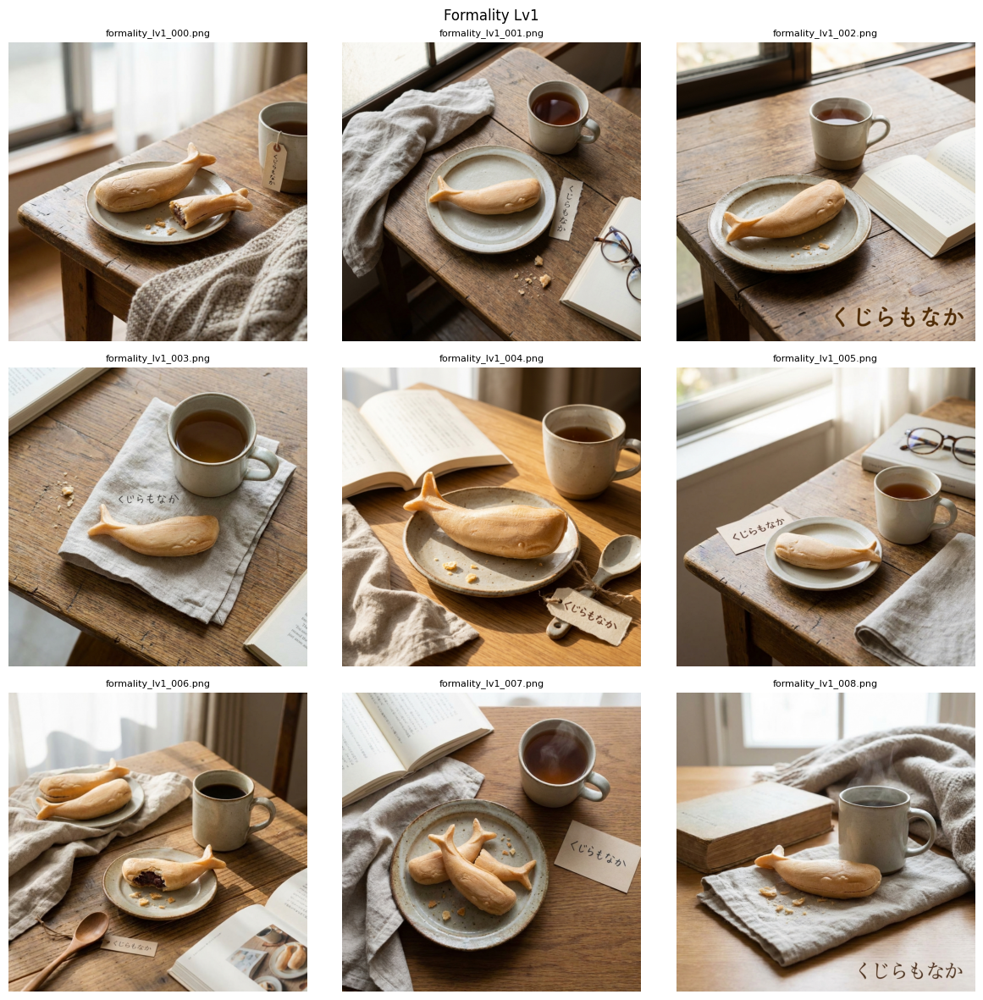

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 2 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv2_008.pn

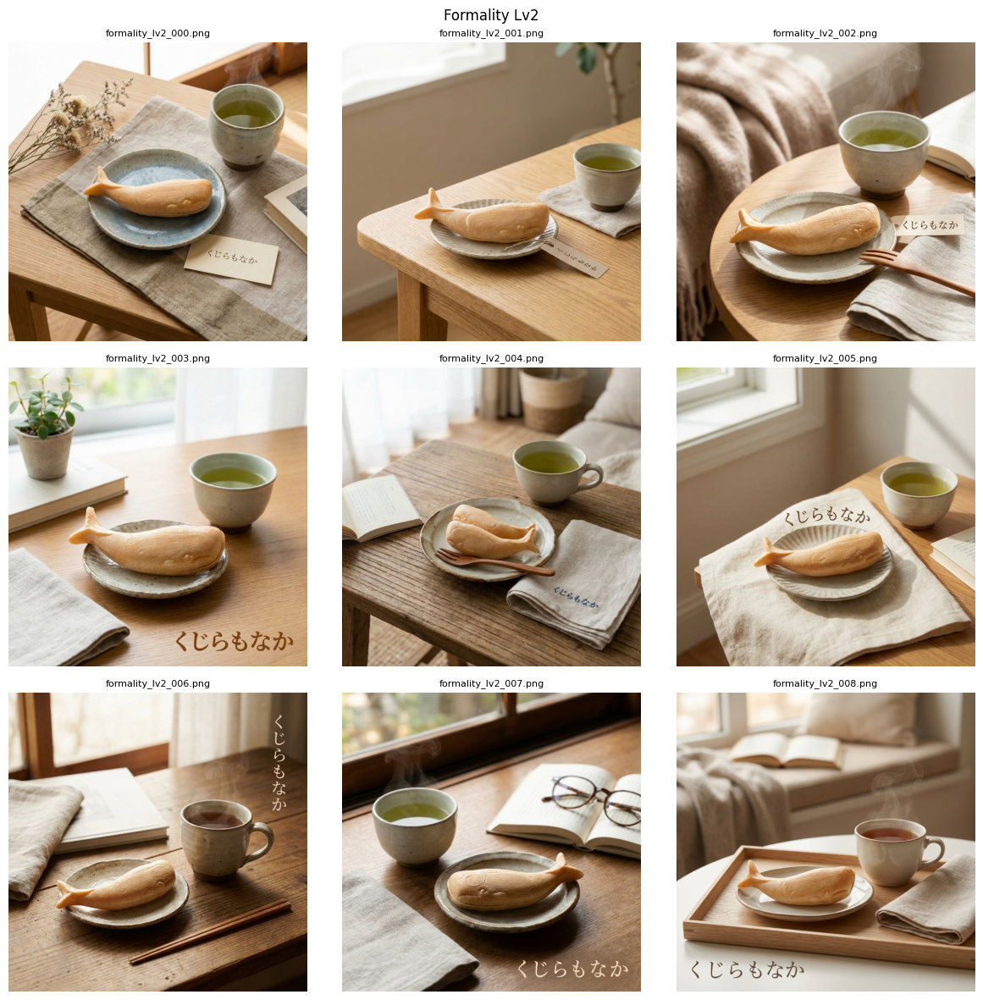

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 3 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv3_008.pn

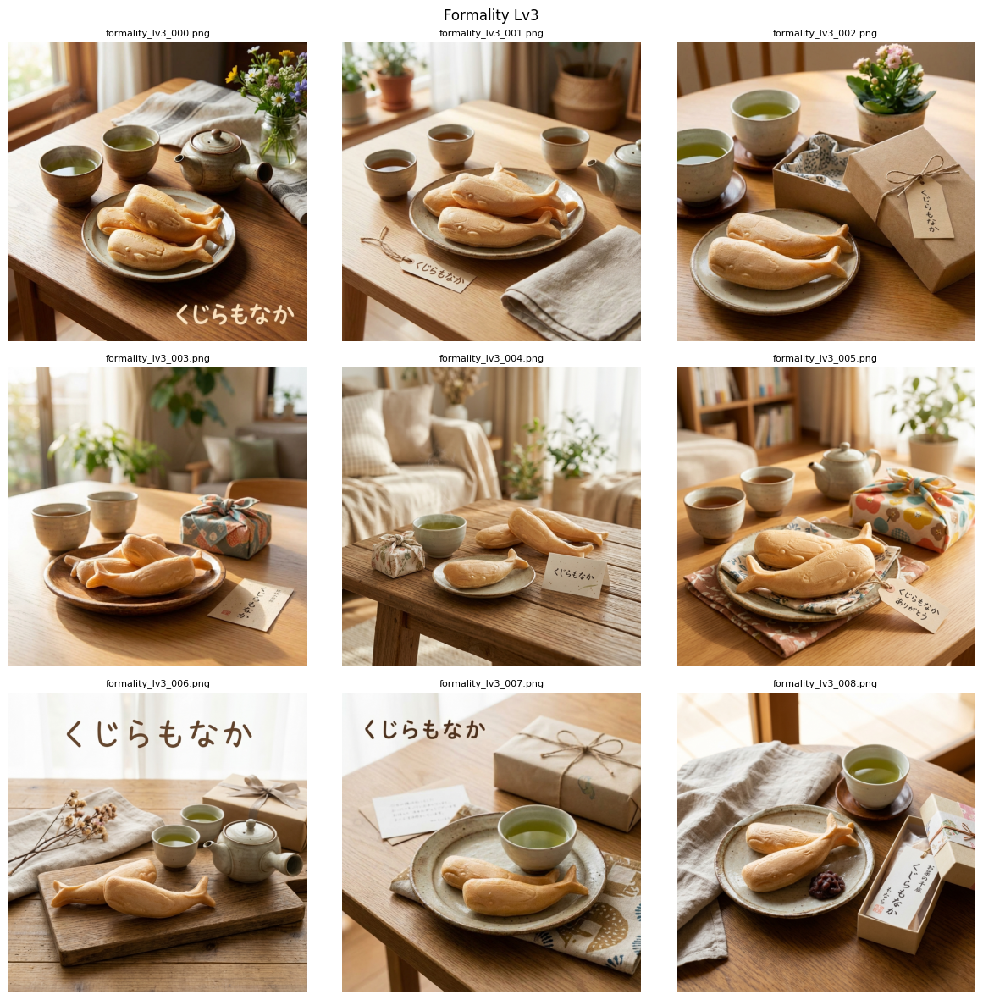

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 4 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv4_008.pn

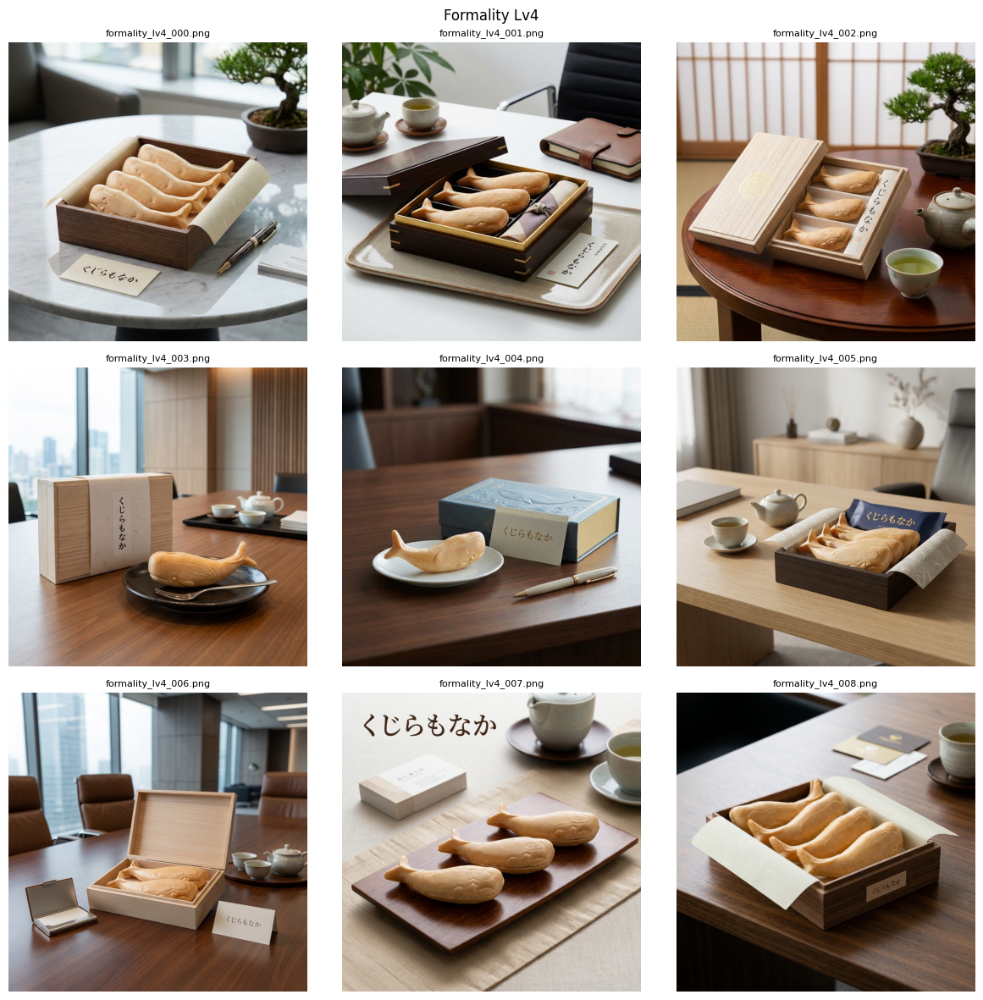

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[FORMALITY] Level 5 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_formality/formality_lv5_008.pn

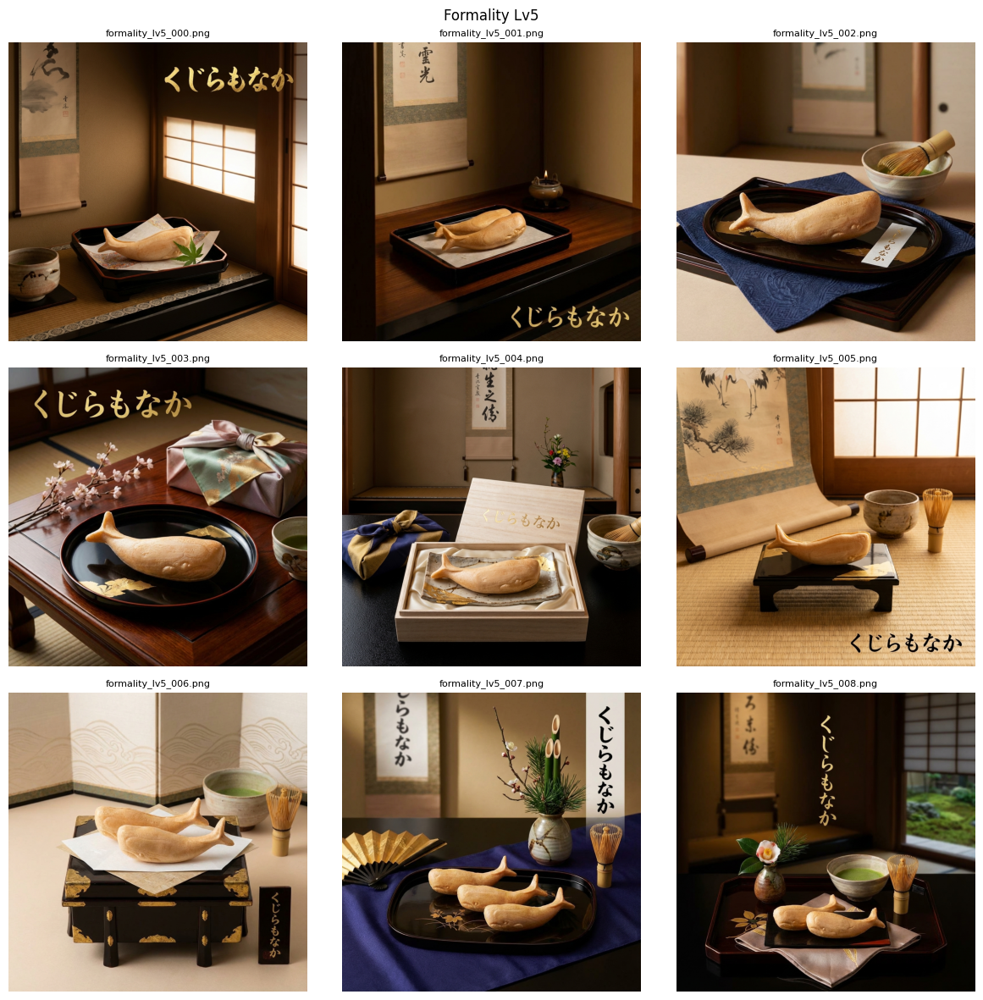

[FORMALITY] Total generated images: 50

>>> Production Run: Lifestage Axis
Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[LIFESTAGE] Level 1 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_007.png
  -> Saved: /content/

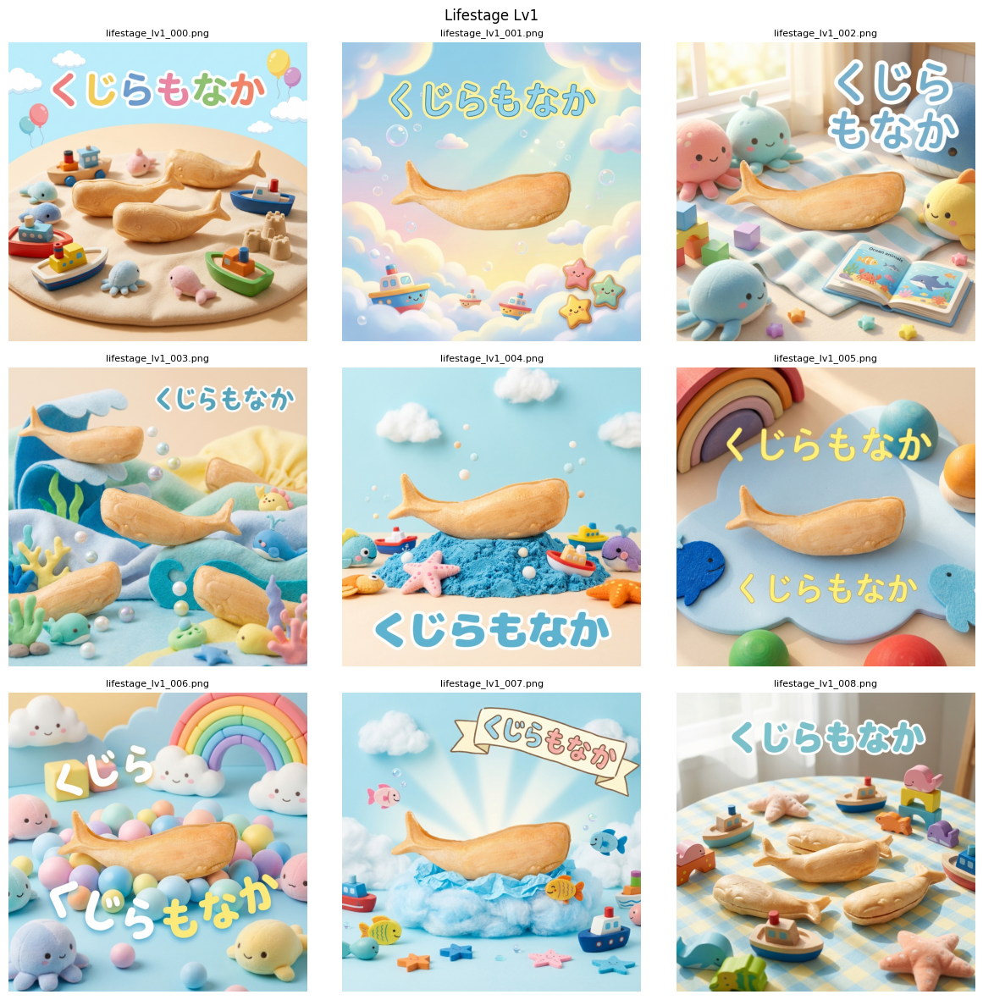

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[LIFESTAGE] Level 2 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv2_008.pn

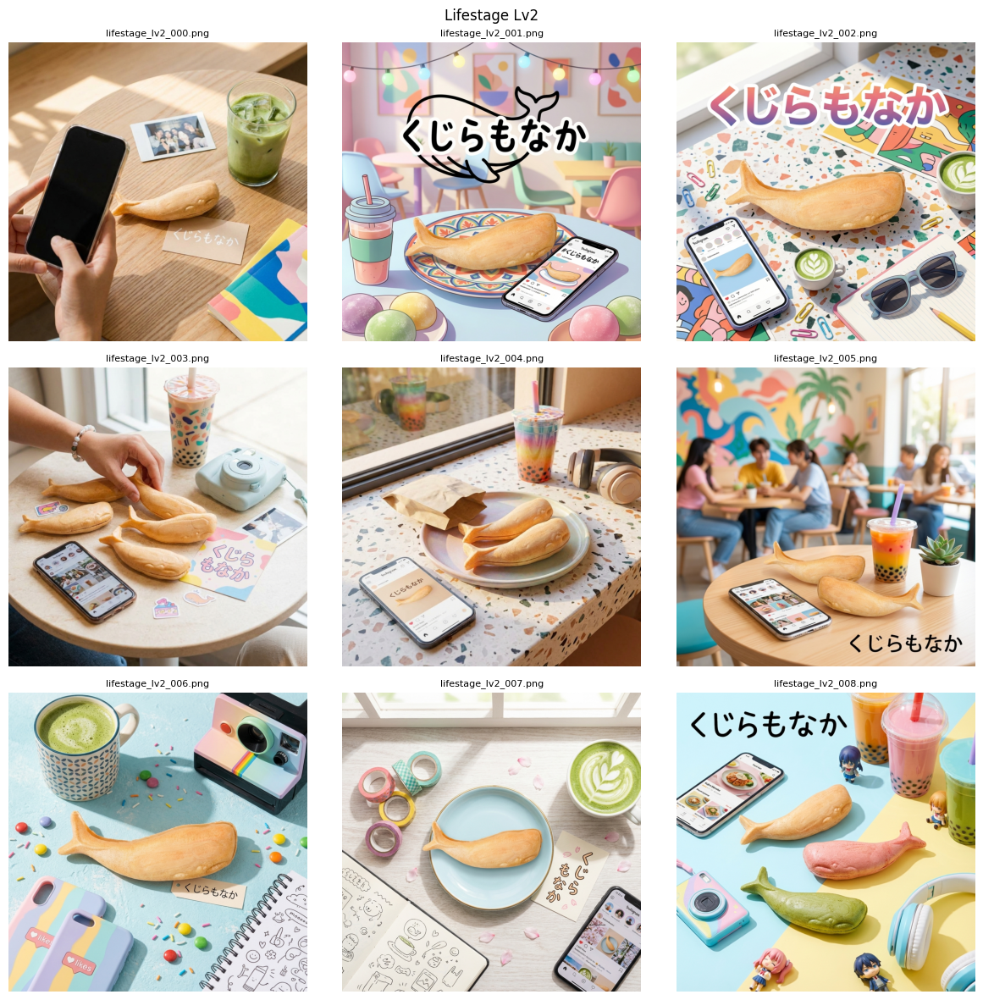

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[LIFESTAGE] Level 3 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv3_008.pn

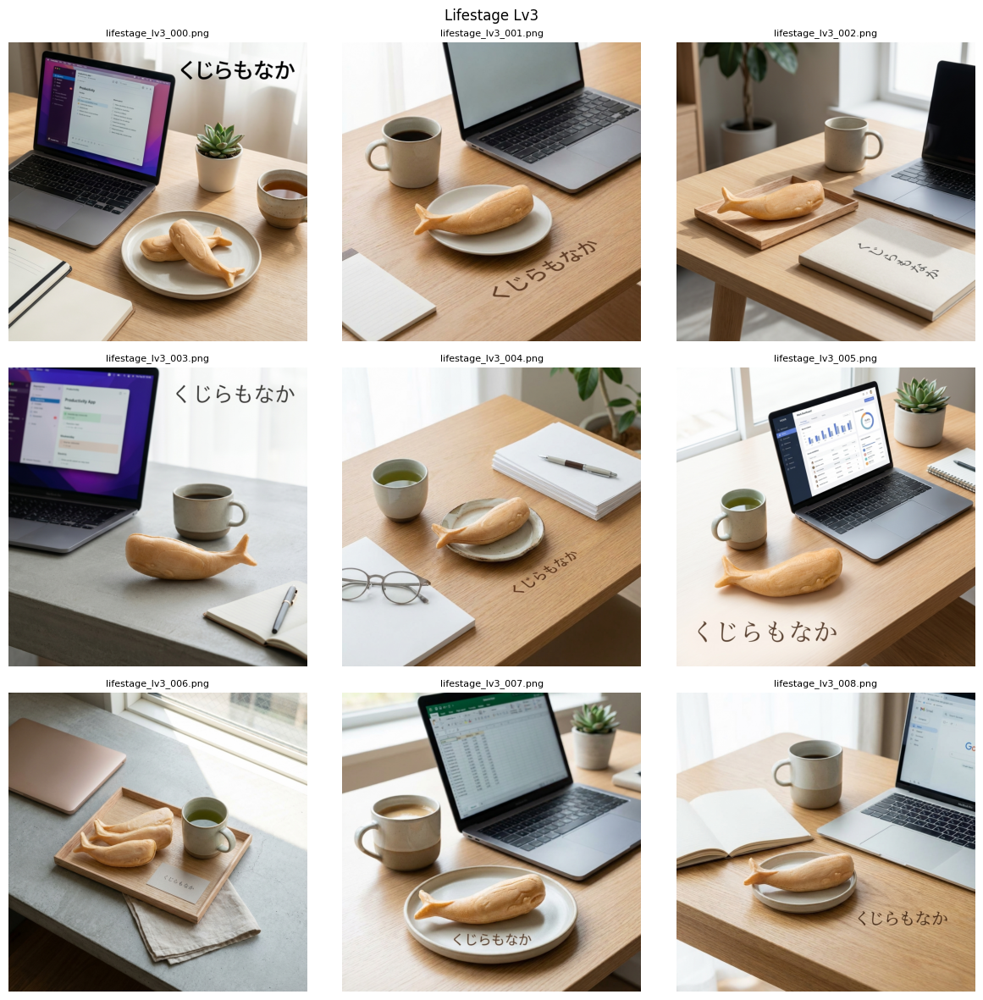

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[LIFESTAGE] Level 4 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv4_008.pn

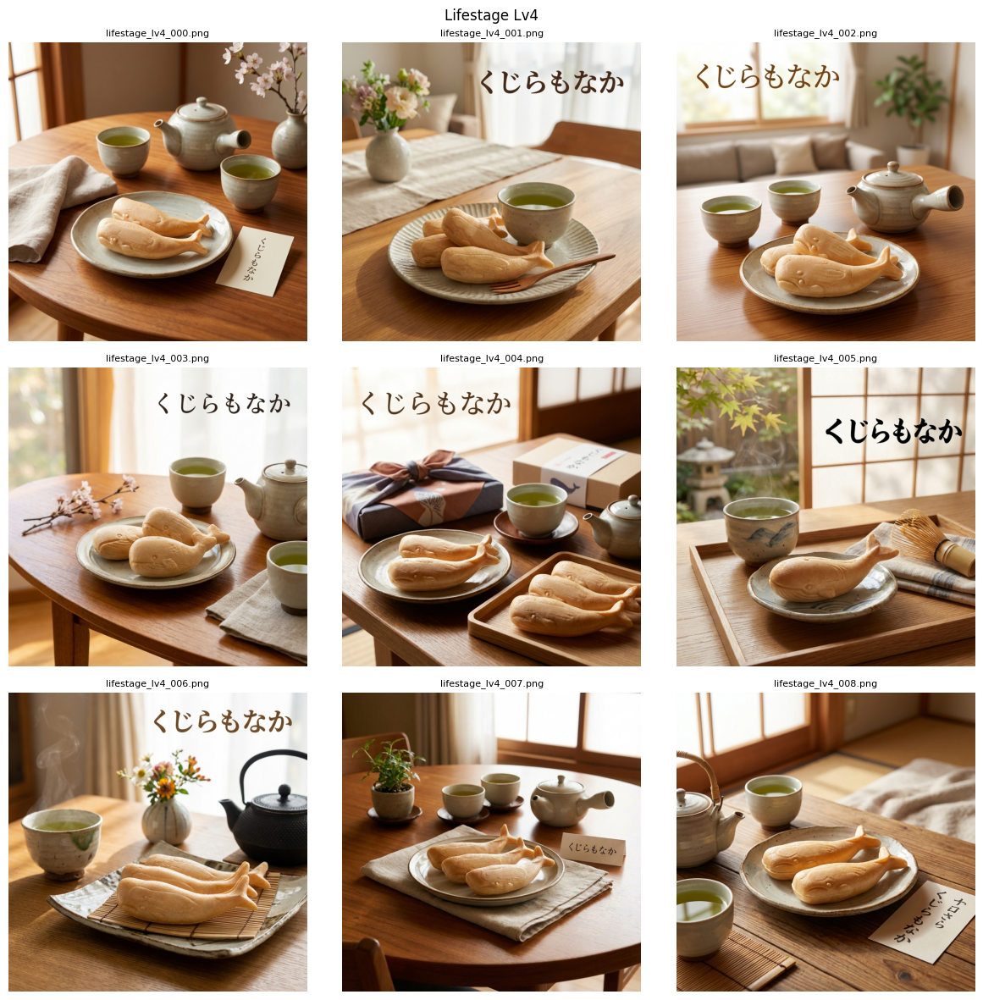

Loading base image from: /content/drive/MyDrive/kujiramonaka_experiment/base/kujira_base.png
[LIFESTAGE] Level 5 / n=10
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_000.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_001.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_002.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_003.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_004.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_005.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_006.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_007.png
  -> Saved: /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv5_008.pn

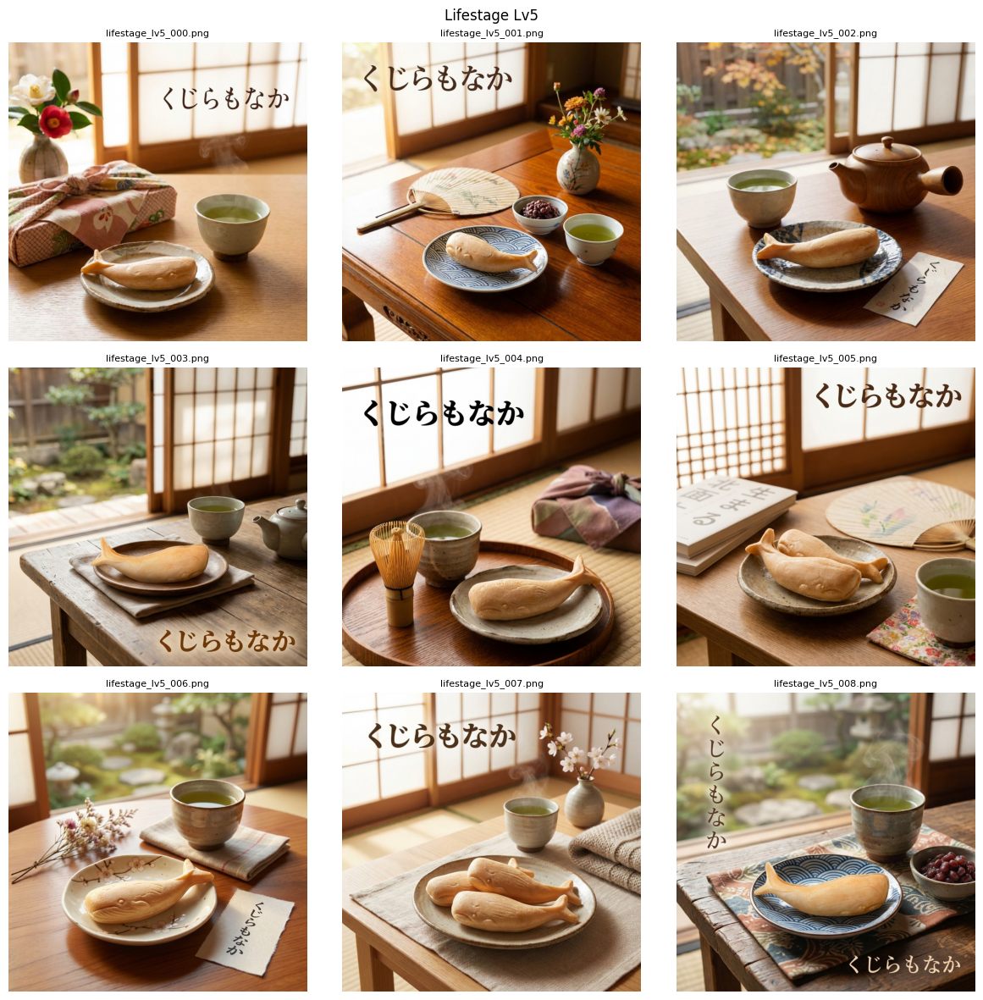

[LIFESTAGE] Total generated images: 50


[PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_000.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_001.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_002.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_003.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_004.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_005.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_006.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_007.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_008.png'),
 PosixPath('/content/drive/MyDrive/kujiramonaka_experiment/images_lifestage/lifestage_lv1_0

In [ ]:
# --- 本番生成 ---

print("\n>>> Production Run: Formality Axis")
generate_formality_all_levels_once(n_images_per_level=10, preview_each_level=True)

print("\n>>> Production Run: Lifestage Axis")
generate_lifestage_all_levels_once(n_images_per_level=10, preview_each_level=True)

# 生成画像を確認する

# セクション3 埋め込み取得トラベルづけ

In [ ]:
# ==========================================
# セクション3: SigLIP 2 による埋め込み取得 (Main Analysis Data)
# ==========================================

# 1. ライブラリの最新化 (SigLIP 2対応のため必須)
!pip install -U -q transformers timm accelerate scikit-learn matplotlib seaborn

import torch
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm import tqdm
from transformers import AutoImageProcessor, SiglipModel

# 2. SigLIP 2 モデル読み込み
device = "cuda" if torch.cuda.is_available() else "cpu"

# ★ここを SigLIP 2 に変更
MODEL_ID = "google/siglip2-so400m-patch16-384"

print(f"Loading SigLIP 2 Model: {MODEL_ID} ...")
try:
    processor = AutoImageProcessor.from_pretrained(MODEL_ID)
    model = SiglipModel.from_pretrained(MODEL_ID).to(device)
    model.eval()
    print("SigLIP 2 Model loaded successfully.")
except Exception as e:
    print(f"Error loading model. Please restart the session and run the pip install cell again.\nError: {e}")
    raise e

# 3. 画像パスとラベルの取得関数
def load_image_paths_and_labels(image_dir: Path, axis: str):
    """
    image_dir: FORMALITY_DIR or LIFESTAGE_DIR
    axis: 'formality' or 'lifestage'
    """
    paths = []
    labels = []
    # ファイルが存在するか確認
    if not image_dir.exists():
        print(f"Directory not found: {image_dir}")
        return [], np.array([])

    files = sorted(list(image_dir.glob("*.png")))

    print(f"[{axis}] Scanning {len(files)} images in {image_dir}...")
    for p in files:
        name = p.name
        try:
            # ex: formality_lv3_005.png
            parts = name.split("_")
            lv_part = next((x for x in parts if x.startswith("lv")), None)
            if lv_part:
                level = int(lv_part.replace("lv", ""))
                paths.append(p)
                labels.append(level)
        except Exception:
            continue

    return paths, np.array(labels, dtype=int)

# 4. 埋め込み計算関数 (SigLIP2:Projected & Pooler)
def compute_image_embeddings(paths, batch_size=16):
    """
    Returns:
      embs_proj: (N, D_proj) - Semantic embeddings (for Classification)
      embs_pool: (N, D_pool) - Visual embeddings (for Diversity check)
    """
    embs_proj = []
    embs_pool = []

    with torch.no_grad():
        for i in tqdm(range(0, len(paths), batch_size), desc="SigLIP 2 Encoding"):
            batch_paths = paths[i : i + batch_size]
            images = [Image.open(p).convert("RGB") for p in batch_paths]

            # Preprocess
            inputs = processor(images=images, return_tensors="pt")
            inputs = {k: v.to(device) for k, v in inputs.items()}

            # Forward Pass (Vision Model)
            vision_outputs = model.vision_model(**inputs)
            pooler_output = vision_outputs.pooler_output  # [B, Hidden] (Visual / MAP Head output)

            # Projection (Semantic)
            image_embeds = model.visual_projection(pooler_output) # [B, Proj]

            # Normalize for Cosine Similarity
            image_embeds = image_embeds / image_embeds.norm(dim=-1, keepdim=True)
            pooler_output = pooler_output / pooler_output.norm(dim=-1, keepdim=True)

            embs_proj.append(image_embeds.cpu().numpy())
            embs_pool.append(pooler_output.cpu().numpy())

    if not embs_proj:
        return None, None

    return np.concatenate(embs_proj, axis=0), np.concatenate(embs_pool, axis=0)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 72.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 106.1 MB/s eta 0:00:00
Loading SigLIP 2 Model: google/siglip2-so400m-patch16-384 ...


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/394 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


config.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/4.54G [00:00<?, ?B/s]

SigLIP 2 Model loaded successfully.


In [ ]:
import numpy as np
from tqdm import tqdm
from PIL import Image
import torch

def compute_siglip2_proj_embeddings(
    paths,
    batch_size: int = 8,
    debug_check: bool = False,
):
    """
    SigLIP2 の projected image embeddings を計算する。

    Returns
    -------
    proj_l2 : np.ndarray
        L2 正規化済み projected embeddings（主分析用）
    proj_raw : np.ndarray
        正規化前 projected embeddings（ノルム検証・付録用）

    Notes
    -----
    - model.get_image_features(**inputs) の出力は（少なくとも本環境では）正規化されていない。
    - 主分析で cos 類似/距離を一貫して扱うため、proj_l2 を用いる。
    """

    if paths is None or len(paths) == 0:
        raise ValueError("No image paths found. Check directory path / glob pattern / extensions.")

    all_l2 = []
    all_raw = []

    model.eval()
    with torch.no_grad():
        for i in tqdm(range(0, len(paths), batch_size), desc="SigLIP2 Encoding"):
            batch_paths = paths[i : i + batch_size]

            # 画像読み込み
            images = [Image.open(p).convert("RGB") for p in batch_paths]

            # 前処理
            inputs = processor(images=images, return_tensors="pt").to(device)

            # projected embedding (joint embedding space)
            proj_raw_t = model.get_image_features(**inputs)  # [B, D]

            # 正規化前（raw）
            proj_raw = proj_raw_t.cpu().numpy()

            # L2 正規化（主分析用）
            proj_l2_t = proj_raw_t / proj_raw_t.norm(dim=-1, keepdim=True).clamp(min=1e-12)
            proj_l2 = proj_l2_t.cpu().numpy()

            # 任意：最初の1バッチだけ確認
            if debug_check and i == 0:
                raw_norms = np.linalg.norm(proj_raw, axis=1)
                l2_norms = np.linalg.norm(proj_l2, axis=1)
                print("=== DEBUG: proj norms (first batch) ===")
                print(f"[raw] mean={raw_norms.mean():.6f}, std={raw_norms.std():.6f}, "
                      f"min={raw_norms.min():.6f}, max={raw_norms.max():.6f}")
                print(f"[l2 ] mean={l2_norms.mean():.6f}, std={l2_norms.std():.6f}, "
                      f"min={l2_norms.min():.6f}, max={l2_norms.max():.6f}")
                print("======================================")

            all_raw.append(proj_raw)
            all_l2.append(proj_l2)

    proj_raw = np.concatenate(all_raw, axis=0)
    proj_l2  = np.concatenate(all_l2, axis=0)

    return proj_l2, proj_raw

# 後方互換性のため、旧関数名も残す
def compute_image_embeddings(paths, batch_size: int = 8):
    """
    後方互換性のためのラッパー関数
    """
    proj_l2, proj_raw = compute_siglip2_proj_embeddings(paths, batch_size, debug_check=False)
    return proj_l2, proj_raw


In [ ]:
# --- 実行 & 保存 ---

# 1. Formality Axis
f_paths, f_labels = load_image_paths_and_labels(FORMALITY_DIR, axis="formality")
if len(f_paths) > 0:
    f_proj_l2, f_proj_raw = compute_siglip2_proj_embeddings(f_paths, debug_check=True)
    np.save(PROJECT_ROOT / "formality_siglip_proj.npy", f_proj_l2) # Main (L2 normalized)
    np.save(PROJECT_ROOT / "formality_siglip_proj_raw.npy", f_proj_raw) # Raw (for norm analysis)
    np.save(PROJECT_ROOT / "formality_labels.npy", f_labels)
    # パスも保存（ロバストネスチェック用）
    np.save(PROJECT_ROOT / "formality_paths.npy", np.array([str(p) for p in f_paths]))
    print("Saved Formality SigLIP 2 embeddings.")

# 2. Lifestage Axis
l_paths, l_labels = load_image_paths_and_labels(LIFESTAGE_DIR, axis="lifestage")
if len(l_paths) > 0:
    l_proj_l2, l_proj_raw = compute_siglip2_proj_embeddings(l_paths, debug_check=True)
    np.save(PROJECT_ROOT / "lifestage_siglip_proj.npy", l_proj_l2) # Main (L2 normalized)
    np.save(PROJECT_ROOT / "lifestage_siglip_proj_raw.npy", l_proj_raw) # Raw (for norm analysis)
    np.save(PROJECT_ROOT / "lifestage_labels.npy", l_labels)
    # パスも保存（ロバストネスチェック用）
    np.save(PROJECT_ROOT / "lifestage_paths.npy", np.array([str(p) for p in l_paths]))
    print("Saved Lifestage SigLIP 2 embeddings.")

[formality] Scanning 50 images in /content/drive/MyDrive/kujiramonaka_experiment/images_formality...


SigLIP 2 Encoding: 100%|██████████| 7/7 [00:28<00:00,  4.12s/it]


Saved Formality SigLIP 2 embeddings.
[lifestage] Scanning 50 images in /content/drive/MyDrive/kujiramonaka_experiment/images_lifestage...


SigLIP 2 Encoding: 100%|██████████| 7/7 [00:35<00:00,  5.10s/it]

Saved Lifestage SigLIP 2 embeddings.


# セクション4: 線形分類 & PCA可視化

In [ ]:
# 必要ライブラリのインストール（初回のみ）
!pip install -q scikit-learn seaborn

In [ ]:
# ==========================================
# セクション4: 分析結果のテーブル化 & 可視化修正版
# ==========================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
from IPython.display import display

# --- 1. データ読み込み ---
try:
    f_embs = np.load(PROJECT_ROOT / "formality_siglip_proj.npy")
    f_labels = np.load(PROJECT_ROOT / "formality_labels.npy")
    l_embs = np.load(PROJECT_ROOT / "lifestage_siglip_proj.npy")
    l_labels = np.load(PROJECT_ROOT / "lifestage_labels.npy")
    print(f"Loaded SigLIP 2 Projected Data -> Formality: {f_embs.shape}, Lifestage: {l_embs.shape}")
except FileNotFoundError:
    print("Embedding files not found. Please run Section 3 first.")

# --- 2. 修正版: PCA可視化関数 (ラベル外出し・テキスト削除) ---
def plot_pca_square(X, y, title="PCA"):
    if len(X) == 0: return
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    # 凡例を外に出すため、横幅を広げる
    plt.figure(figsize=(8, 6))

    classes = sorted(np.unique(y))
    # クラスごとに色を指定してプロット
    for c in classes:
        mask = (y == c)
        plt.scatter(X_pca[mask, 0], X_pca[mask, 1],
                    label=f"Lv.{c}",
                    alpha=0.7,
                    s=50,
                    edgecolor='white', linewidth=0.5)

    # アスペクト比を固定
    plt.gca().set_aspect('equal', adjustable='datalim')

    plt.title(f"{title}\n(PC1={pca.explained_variance_ratio_[0]:.2f}, PC2={pca.explained_variance_ratio_[1]:.2f})")
    plt.xlabel("PC1")
    plt.ylabel("PC2")

    # ★凡例をグラフの外側(右)に配置
    plt.legend(title="Levels", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

    plt.grid(True, linestyle="--", alpha=0.3)
    plt.tight_layout()
    plt.show()

# --- 3. 混同行列関数 (CV予測ベース) ---
def plot_confusion_matrix_square(X, y, title="Confusion Matrix"):
    if len(X) == 0: return

    clf = LogisticRegression(max_iter=2000, random_state=42, class_weight='balanced')
    n_splits = 5 if len(np.unique(y)) >= 2 and len(y) > 10 else 2
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

    try:
        y_pred = cross_val_predict(clf, X, y, cv=skf)
    except ValueError:
        clf.fit(X, y)
        y_pred = clf.predict(X)

    all_labels = [1, 2, 3, 4, 5]
    cm = confusion_matrix(y, y_pred, labels=all_labels)

    plt.figure(figsize=(5, 5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                square=True, cbar=False,
                xticklabels=all_labels, yticklabels=all_labels)

    plt.title(f"{title}\n(Cross-Validated Predictions)")
    plt.xlabel("Predicted Level")
    plt.ylabel("True Level")
    plt.show()

# --- 4. 指標計算 & テーブル作成関数 ---
def calculate_metrics(X, y, name):
    metrics = {"Axis": name}

    # A. Linear Classifier
    n_splits = 5 if len(np.unique(y)) >= 2 and len(y) > 10 else 2
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    accs, f1s = [], []
    for train_idx, test_idx in skf.split(X, y):
        clf = LogisticRegression(max_iter=2000, multi_class="multinomial", solver="lbfgs", class_weight='balanced')
        clf.fit(X[train_idx], y[train_idx])
        pred = clf.predict(X[test_idx])
        accs.append(accuracy_score(y[test_idx], pred))
        f1s.append(f1_score(y[test_idx], pred, average="macro"))

    metrics["Accuracy"] = f"{np.mean(accs):.3f} ± {np.std(accs):.3f}"
    metrics["Macro F1"] = f"{np.mean(f1s):.3f} ± {np.std(f1s):.3f}"

    # B. Silhouette
    if len(np.unique(y)) > 1:
        sil = silhouette_score(X, y, metric="cosine")
        metrics["Silhouette (Cos)"] = f"{sil:.4f}"
    else:
        metrics["Silhouette (Cos)"] = "N/A"

    # C. Intra-class Diversity (Overall Mean)
    classes = sorted(np.unique(y))
    dists = []
    for c in classes:
        vecs = X[y == c]
        if len(vecs) < 2: continue
        sim = np.dot(vecs, vecs.T)
        upper = np.triu_indices(len(vecs), k=1)
        dists.append(1.0 - sim[upper].mean())

    metrics["Diversity (Mean Dist)"] = f"{np.mean(dists):.4f}" if dists else "N/A"

    return metrics

def run_full_analysis_with_table(data_dict):
    # 1. サマリーテーブル作成
    results = []
    for name, (X, y) in data_dict.items():
        if X is not None and len(X) > 0:
            results.append(calculate_metrics(X, y, name))

    df_results = pd.DataFrame(results)
    print("\n=== Analysis Summary Table ===")
    display(df_results)

    # 2. 詳細分析 (行列 & グラフ)
    for name, (X, y) in data_dict.items():
        if X is None or len(X) == 0: continue

        print(f"\n{'='*20} Details: {name} {'='*20}")

        # クラス内多様性の詳細表示
        print("[Intra-class Diversity per Level]")
        classes = sorted(np.unique(y))
        for c in classes:
            vecs = X[y == c]
            if len(vecs) < 2: continue
            sim = np.dot(vecs, vecs.T)
            upper = np.triu_indices(len(vecs), k=1)
            mean_d = 1.0 - sim[upper].mean()
            print(f"  Lv.{c}: {mean_d:.4f}")

        # 重心間距離行列
        centroids = np.array([X[y == c].mean(axis=0) for c in classes])
        centroids = centroids / np.linalg.norm(centroids, axis=1, keepdims=True)
        dist_mat = 1.0 - np.dot(centroids, centroids.T)
        print("\n[Centroid Distance Matrix]")
        display(pd.DataFrame(dist_mat, index=[f"L{c}" for c in classes], columns=[f"L{c}" for c in classes]).round(3))

        # 可視化
        plot_pca_square(X, y, title=f"{name} PCA")
        plot_confusion_matrix_square(X, y, title=f"{name} Confusion Matrix")

Loaded SigLIP 2 Projected Data -> Formality: (50, 1152), Lifestage: (50, 1152)


/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi


=== Analysis Summary Table ===


,Axis,Accuracy,Macro F1,Silhouette (Cos),Diversity (Mean Dist)
0,Formality,0.800 ± 0.063,0.772,0.1292,0.1217
1,Lifestage,0.880 ± 0.075,0.877,0.1874,0.1385



==================== Details: Formality ====================
[Intra-class Diversity per Level]
  Lv.1: 0.0920
  Lv.2: 0.0934
  Lv.3: 0.1138
  Lv.4: 0.1673
  Lv.5: 0.1418

[Centroid Distance Matrix]


,L1,L2,L3,L4,L5
L1,0.000,0.018,0.055,0.128,0.139
L2,0.018,0.000,0.043,0.110,0.107
L3,0.055,0.043,0.000,0.080,0.084
L4,0.128,0.110,0.080,-0.000,0.076
L5,0.139,0.107,0.084,0.076,-0.000


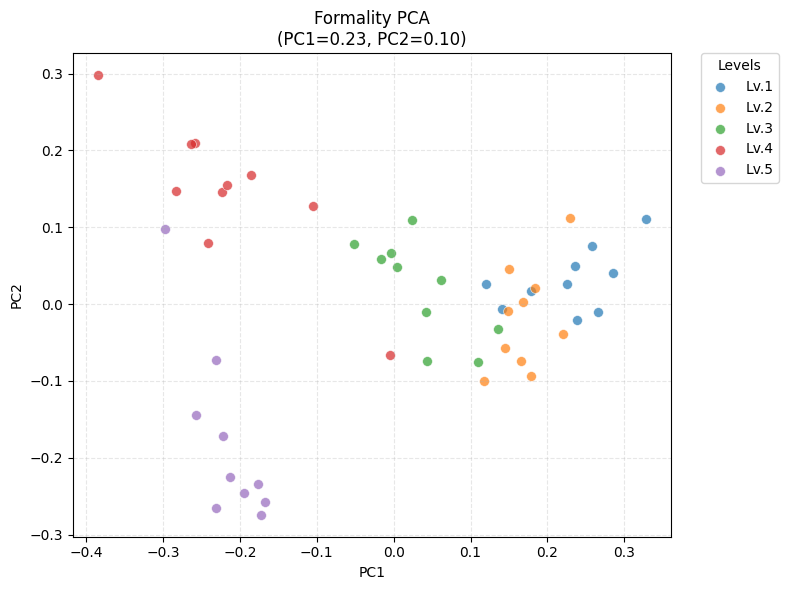

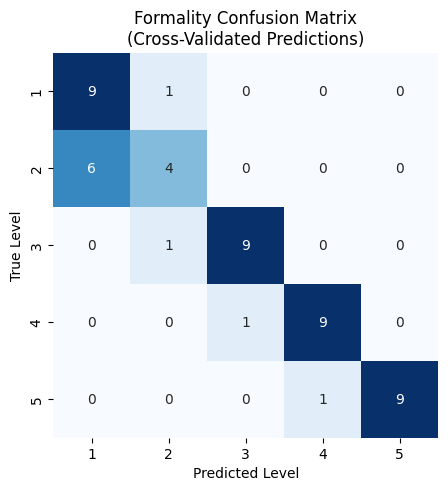


==================== Details: Lifestage ====================
[Intra-class Diversity per Level]
  Lv.1: 0.1278
  Lv.2: 0.1976
  Lv.3: 0.1361
  Lv.4: 0.0966
  Lv.5: 0.1345

[Centroid Distance Matrix]


,L1,L2,L3,L4,L5
L1,-0.000,0.114,0.182,0.148,0.160
L2,0.114,-0.000,0.122,0.125,0.132
L3,0.182,0.122,-0.000,0.108,0.117
L4,0.148,0.125,0.108,0.000,0.019
L5,0.160,0.132,0.117,0.019,0.000


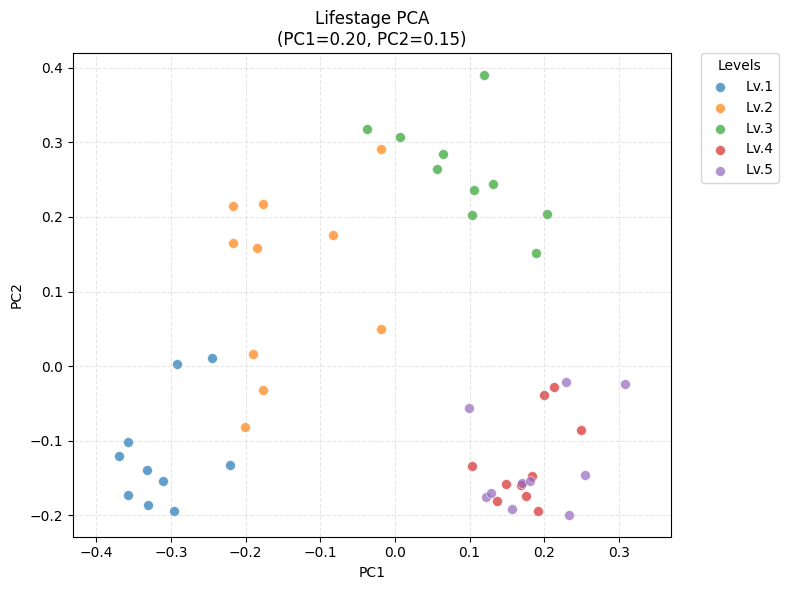

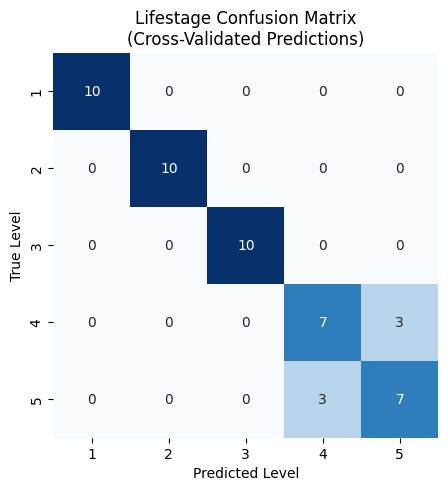

In [ ]:
# --- 実行 ---
data_to_analyze = {}
if 'f_embs' in locals(): data_to_analyze["Formality"] = (f_embs, f_labels)
if 'l_embs' in locals(): data_to_analyze["Lifestage"] = (l_embs, l_labels)

run_full_analysis_with_table(data_to_analyze)

In [14]:
# ==========================================
# セクション X: 生成画像のギャラリー表示 (Gallery Visualization)
# ==========================================

import matplotlib.pyplot as plt
from PIL import Image
import math

def display_level_gallery(image_dir, axis_name, samples_per_level=5):
    """
    指定されたディレクトリ内の画像をレベルごとに収集し、グリッド表示する関数。

    Args:
        image_dir (Path): 画像が保存されているディレクトリ (FORMALITY_DIR 等)
        axis_name (str): グラフのタイトルに使う軸の名前
        samples_per_level (int): 各レベルで表示する画像の最大枚数
    """
    if not image_dir.exists():
        print(f"Directory not found: {image_dir}")
        return

    # レベル1〜5を対象とする
    levels = range(1, 6)

    # 1. 画像パスをレベルごとに収集
    level_images = {lv: [] for lv in levels}
    all_files = sorted(list(image_dir.glob("*.png")))

    for p in all_files:
        try:
            # ファイル名からレベルを抽出 (例: formality_lv3_005.png)
            parts = p.name.split("_")
            lv_part = next((x for x in parts if x.startswith("lv")), None)
            if lv_part:
                lv = int(lv_part.replace("lv", ""))
                if lv in level_images:
                    level_images[lv].append(p)
        except Exception:
            continue

    # 2. グリッド描画設定 (行:レベル, 列:サンプル数)
    rows = 5
    cols = samples_per_level

    # 図のサイズ調整 (画像数に応じて可変)
    fig_width = 3 * cols
    fig_height = 3.5 * rows

    fig, axes = plt.subplots(rows, cols, figsize=(fig_width, fig_height))
    fig.suptitle(f"{axis_name} Axis Gallery (Levels 1-5)", fontsize=20, y=1.02)

    # 3. 各レベルの画像を描画
    for r, level in enumerate(levels):
        images = level_images[level]
        show_images = images[:cols]  # 先頭から指定枚数だけ取得

        for c in range(cols):
            # subplotの軸取得 (1行や1列の場合の挙動差異を吸収)
            if rows > 1 and cols > 1:
                ax = axes[r, c]
            elif rows > 1:
                ax = axes[r]
            elif cols > 1:
                ax = axes[c]
            else:
                ax = axes

            # 画像表示
            if c < len(show_images):
                img_path = show_images[c]
                try:
                    img = Image.open(img_path)
                    ax.imshow(img)
                    ax.set_title(f"Lv{level} / {img_path.name}", fontsize=9)
                except Exception as e:
                    ax.text(0.5, 0.5, "Load Error", ha='center', va='center')
            else:
                # 画像がない場所は空白orメッセージ
                ax.text(0.5, 0.5, "-", ha='center', va='center', color='lightgray')

            ax.axis("off")

            # 各行の左端に見出しとしてレベルを表示
            if c == 0:
                ax.text(-0.25, 0.5, f"Level {level}", transform=ax.transAxes,
                        fontsize=14, va='center', ha='right', fontweight='bold')

    plt.tight_layout()
    plt.show()

# セクション6: ノルムの確認


In [ ]:
# ベクトルのノルムを確認

import numpy as np

def check_vector_norms(X, name="Embedding"):
    norms = np.linalg.norm(X, axis=1)
    print(f"=== {name} ===")
    print(f"count : {len(norms)}")
    print(f"mean  : {norms.mean():.6f}")
    print(f"std   : {norms.std():.6f}")
    print(f"min   : {norms.min():.6f}")
    print(f"max   : {norms.max():.6f}")
    print()

# フォーマリティ
if 'f_embs' in locals():
    check_vector_norms(f_embs, "Formality SigLIP2 (L2 normalized)")

# ライフステージ
if 'l_embs' in locals():
    check_vector_norms(l_embs, "Lifestage SigLIP2 (L2 normalized)")


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix


# ----------------------------
# A) 付録用：ノルム分布図
# ----------------------------
def plot_norm_distribution_by_level(
    proj_raw: np.ndarray,
    labels: np.ndarray,
    title: str,
    kind: str = "box",          # "box" or "violin"
    save_path: str | None = None,
):
    labels = np.asarray(labels).astype(int)
    norms = np.linalg.norm(proj_raw, axis=1)

    df = pd.DataFrame({"Level": labels, "Norm": norms}).sort_values("Level")
    levels = sorted(df["Level"].unique())

    plt.figure(figsize=(7, 4))
    data = [df.loc[df["Level"] == lv, "Norm"].values for lv in levels]

    if kind == "box":
        plt.boxplot(data, tick_labels=[f"Lv.{lv}" for lv in levels], showfliers=True)
    elif kind == "violin":
        plt.violinplot(data, showmeans=True, showmedians=True)
        plt.xticks(range(1, len(levels) + 1), [f"Lv.{lv}" for lv in levels])
    else:
        raise ValueError("kind must be 'box' or 'violin'")

    plt.title(title)
    plt.xlabel("Level")
    plt.ylabel("L2 Norm of raw projected embeddings")
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"[Saved] {save_path}")

    plt.show()

    summary = df.groupby("Level")["Norm"].agg(["count", "mean", "std", "min", "max"])
    display(summary)

    return df, summary


# ----------------------------
# B) 付録用：ノルム単独分類（任意）
# ----------------------------
def evaluate_norm_only_classification(
    proj_raw: np.ndarray,
    labels: np.ndarray,
    title: str,
    n_splits: int = 5,
    save_cm_path: str | None = None,
):
    y = np.asarray(labels).astype(int)
    X = np.linalg.norm(proj_raw, axis=1).reshape(-1, 1)

    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    clf = LogisticRegression(max_iter=2000, class_weight="balanced")
    y_pred = cross_val_predict(clf, X, y, cv=skf)

    acc = accuracy_score(y, y_pred)
    mf1 = f1_score(y, y_pred, average="macro")

    print(f"=== {title} (Norm-only, {n_splits}-fold CV) ===")
    print(f"Accuracy : {acc:.3f}  (Chance=0.200)")
    print(f"Macro-F1 : {mf1:.3f}  (Chance~0.200)")

    all_labels = [1, 2, 3, 4, 5]
    cm = confusion_matrix(y, y_pred, labels=all_labels)

    plt.figure(figsize=(5, 4))
    plt.imshow(cm, interpolation="nearest")
    plt.title(f"{title}\nConfusion Matrix (Norm-only CV)")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.xticks(range(len(all_labels)), [f"Lv.{i}" for i in all_labels])
    plt.yticks(range(len(all_labels)), [f"Lv.{i}" for i in all_labels])
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(j, i, str(cm[i, j]), ha="center", va="center")
    plt.tight_layout()

    if save_cm_path:
        plt.savefig(save_cm_path, dpi=300)
        print(f"[Saved] {save_cm_path}")

    plt.show()
    return {"accuracy": acc, "macro_f1": mf1, "cm": cm}


# ----------------------------
# C) 2軸をまとめて処理
# ----------------------------
def run_appendix_norm_checks_for_two_axes(
    project_root,
    formality_dir,
    lifestage_dir,
    batch_size: int = 8,
    make_norm_only: bool = True,      # 任意：ノルム単独分類までやるか
    kind: str = "box",                # "box" or "violin"
):
    axes = [
        ("formality", formality_dir, "A.1", "A.2"),
        ("lifestage", lifestage_dir, "A.3", "A.4"),
    ]

    outputs = {}

    for axis, img_dir, fig_norm_id, fig_cm_id in axes:
        print("\n" + "=" * 70)
        print(f"[{axis}] loading paths & labels from: {img_dir}")

        paths, labels = load_image_paths_and_labels(img_dir, axis)
        print(f"[{axis}] paths={len(paths)}, labels={labels.shape}, unique={np.unique(labels)}")

        if len(paths) == 0:
            print(f"[WARN] {axis}: no images found. Skip.")
            continue

        # embeddings
        proj_l2, proj_raw = compute_siglip2_proj_embeddings(
            paths=paths,
            batch_size=batch_size,
            debug_check=True
        )
        print(f"[{axis}] proj_l2 shape={proj_l2.shape}, proj_raw shape={proj_raw.shape}")

        # save embeddings (optional but useful)
        np.save(project_root / f"{axis}_siglip2_proj_l2.npy", proj_l2)
        np.save(project_root / f"{axis}_siglip2_proj_raw.npy", proj_raw)
        print(f"[Saved] {project_root / f'{axis}_siglip2_proj_l2.npy'}")
        print(f"[Saved] {project_root / f'{axis}_siglip2_proj_raw.npy'}")

        # Appendix norm distribution figure
        norm_fig_path = project_root / f"appendix_{axis}_norm_{kind}.png"
        df_norm, summary = plot_norm_distribution_by_level(
            proj_raw=proj_raw,
            labels=labels,
            title=f"Appendix {fig_norm_id}: Norm distribution by {axis.capitalize()} level (raw proj)",
            kind=kind,
            save_path=str(norm_fig_path),
        )

        # Optional: norm-only classification + confusion matrix
        cm_res = None
        if make_norm_only:
            cm_fig_path = project_root / f"appendix_{axis}_normonly_cm.png"
            cm_res = evaluate_norm_only_classification(
                proj_raw=proj_raw,
                labels=labels,
                title=f"Appendix {fig_cm_id}: {axis.capitalize()} classification using Norm only",
                save_cm_path=str(cm_fig_path),
            )

        outputs[axis] = {
            "paths": paths,
            "labels": labels,
            "proj_l2": proj_l2,
            "proj_raw": proj_raw,
            "norm_summary": summary,
            "norm_df": df_norm,
            "norm_fig_path": norm_fig_path,
            "norm_only_result": cm_res,
        }

    print("\nDone.")
    return outputs


# 実行（2軸全部）
outputs = run_appendix_norm_checks_for_two_axes(
    project_root=PROJECT_ROOT,
    formality_dir=FORMALITY_DIR,
    lifestage_dir=LIFESTAGE_DIR,
    batch_size=8,
    make_norm_only=True,   # True推奨（付録の主張が堅くなる）
    kind="box"
)


>>> Displaying Formality Axis Gallery


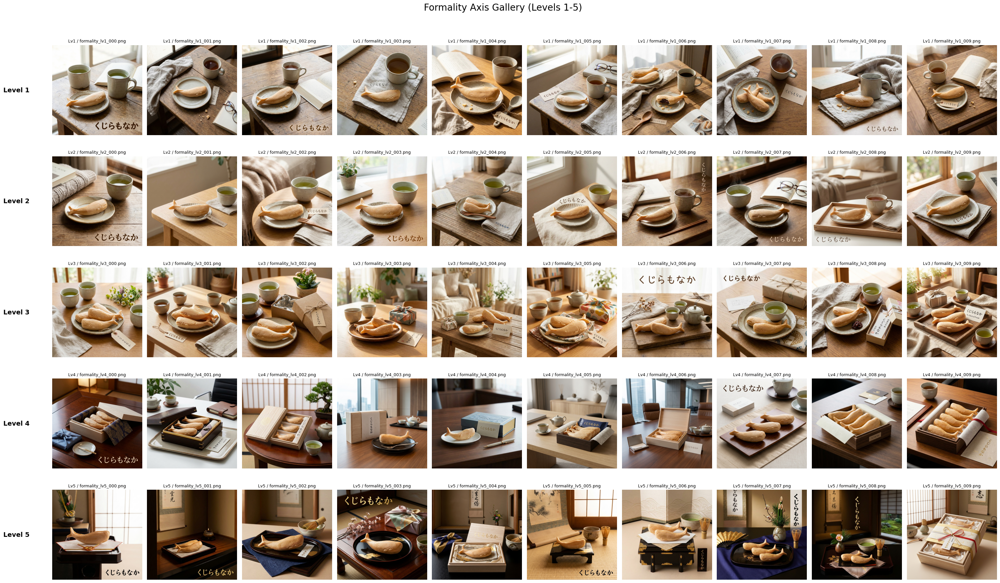



>>> Displaying Lifestage Axis Gallery


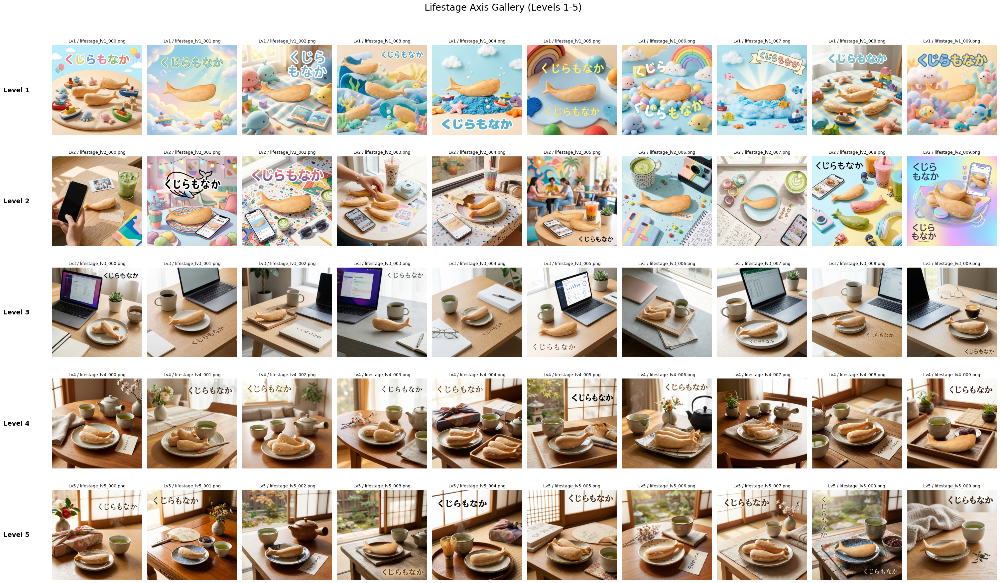

In [15]:
# --- 実行 ---

print(">>> Displaying Formality Axis Gallery")
display_level_gallery(FORMALITY_DIR, axis_name="Formality", samples_per_level=10)

print("\n" + "="*80 + "\n")

print(">>> Displaying Lifestage Axis Gallery")
display_level_gallery(LIFESTAGE_DIR, axis_name="Lifestage", samples_per_level=10)